# Mammalian Cortical Surface Reconstruction

Cortical Surface reconstruction from an MRI image is a very involved task, we will make it only slightly easier by providing you with the segmentation, which you will need to reconstruct the surface. In this notebook you will learn to work with this 3D data, learn to reconstruct surfaces, and extract measurements for comparative studies.

We will however also show that the segmentation itself is often not sufficient for accurate reconstructions due to the high degree of folding. We instead propose a novel method which relies on first reconstructing the White Matter Surface, and the displacing it to the Pial surface.

But no worries, we will get you through it...

## Prerequisites

Here we first download the modules we require for execution

In [1]:
! pip install -r requirements.txt

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import nibabel as nib
import trimesh
import scipy
import skimage

And then download the data we need from our repository

In [13]:
! git clone https://github.com/TimoBl/CorticalSegmentationRepository

Cloning into 'CorticalSegmentationRepository'...
remote: Enumerating objects: 46, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 46 (delta 3), reused 12 (delta 2), pack-reused 24 (from 1)
Receiving objects: 100% (46/46), 299.41 MiB | 32.71 MiB/s, done.
Resolving deltas: 100% (6/6), done.
Updating files: 100% (18/18), done.


## Working with Segmentations

MRI images are acquired in a DICOM format, which are actually only stacks of 2D images oriented in a certain space. The scientific (imaging) community has largely shifted to Nifti images due to their simplicity. Each image is represent as a 3D array of numbers, and an affine matrix which tells us the orientation, position and resolution in the scanner space. More information about this on the [Nibabel website](https://nipy.org/nibabel/coordinate_systems.html). So we will load one of our specimens, the sealion



In [14]:
species = "out_sealion"

seg = nib.load("/content/CorticalSegmentationRepository/" + species + "/seg.nii.gz")
img, affine = seg.get_fdata().astype(int), seg.affine

We can view the 3D image by slicing it with an index, on any of the three axis (axial, sagittal, coronal)

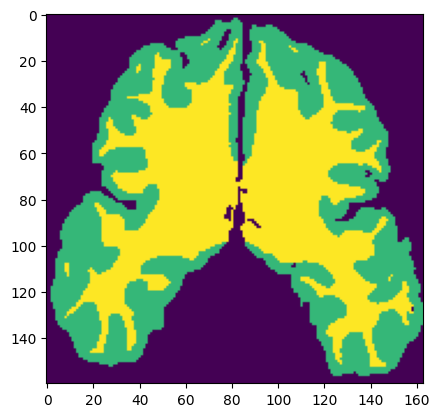

In [16]:
plt.imshow(img[:, 50])

Normally, each voxel in the image will have any float value, but in a segmentation image, each voxel will have a discrete categorical variable assigned. In our case, 0 will represent the background, 3 the white matter, 2 the grey matter. So we can access each class individually

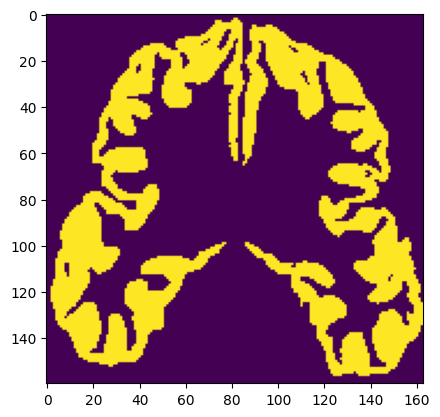

In [17]:
plt.imshow((img == 2)[:, 50])

Now we could for example count the number of voxel to get our volume measurements. The problem is each voxel will have a volume which is dependent on the resolution of the original image. Happily we can extract this information from the header, which give the size in mm

In [18]:
pixdim = seg.header["pixdim"][1:4]
pixdim

array([0.78125  , 0.7799988, 0.78125  ], dtype=float32)

In [19]:
pixel_vol = np.prod(pixdim)
pixel_vol

np.float32(0.47607347)

In [20]:
volume = (img == 2).sum() * pixel_vol
volume

np.float64(263448.58672469854)

So we have succesfully extracted the volume of the grey matter in mm.

**Exercises:**
 * give the white matter volume and the whole brain volume in liters
 * give the number of voxels in each coronal slice, and find the index of the "widest" slice (or part) of the brain

## Reconstructing the Surface

Now we only have the volumetric measurements of the brain, but not the surface measurements. One of the most commonly used algorithm to go from the voxel space to a polygonal mesh is the marching cubes algorithm.

In [21]:
mask = (img > 0).astype(int)

In [22]:
vert, fcs, _, val = skimage.measure.marching_cubes(1 - mask, allow_degenerate=False)
pial_srf = trimesh.base.Trimesh(vertices=vert, faces=fcs)

In [23]:
pial_srf.show()

And we already have the pial surface! But you will see that it's heavily jagged, so we will use smoothing. Different methods with different settings can be used

In [24]:
pial_srf = trimesh.smoothing.filter_humphrey(pial_srf)
pial_srf.show()

You will observe that the surfaces might include some artefacts, or holes. The [trimesh library](https://trimesh.org/trimesh.repair.html) has a number of functions to deal with this. However, we also have to be aware that most of these artefacts come from the segmentation itself, which is by nature not perfect

**Exercises**
* Try to improve the segmentation (suggestions: full connectivity and flood filling)
* Find ways to remove artefacts from the surface mesh itself
* Marching cubes algorithms can also use information about the heigth, meaning that each voxel has also a scalar information about where the surface actually is. We suggest experimenting with chamber distance transforms (scipy.ndimage.
distance_transform_cdt)



## Displacing the surface

Even when improving the pial surfaces, they look slightly melted and tend to miss a lot of informations. However, something interesting happens when we look at the white matter surface

In [25]:
mask = (img == 3).astype(int)

In [26]:
vert, fcs, _, val = skimage.measure.marching_cubes(1 - mask, allow_degenerate=False)
white_srf = trimesh.base.Trimesh(vertices=vert, faces=fcs)
white_srf = trimesh.smoothing.filter_humphrey(white_srf)

In [27]:
white_srf.show()

The surface looks astoundingly good, especially the sulcis which tend to be extremly well preserved. The reason is that in the pial surface, voxels from opposing walls will be labeled as grey matter with no outside voxel in between, meaning the will just fuse together. We are inherently limited by the resolution of the original scan. In the white matter however, there will be grey matter sitting above it, separating the sulci and opening it up

Our fundammental assumption we will make from now, is that we can find a correspondance between the white matter surface and the pial surface. This is a problem which has already been discussed about cortical thickness measurements. We will rely on DiReCT [https://doi.org/10.1016/j.neuroimage.2008.12.016](https://doi.org/10.1016/j.neuroimage.2008.12.016), a diffeomorphic displacement method which will try to morph the white matter segmentation into the grey matter segmentation, through the use of velocity field.

We won't go into the details of the method, but in summary it produces a 3D velocity field, with 10 different timepoints. The method can take around 30 minutes to run, so we pre-processed the examples for you

In [28]:
vel = nib.load("/content/CorticalSegmentationRepository/" + species + "/ForwardVelocityField.nii.gz").get_fdata()
vel.shape

(160, 95, 163, 10, 3)

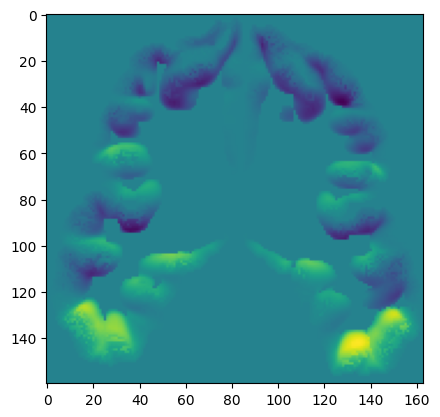

In [29]:
T = 9
axis = 0
plt.imshow(vel[:, 50, :, T, axis])

Now we want to displace our points from the white matter mesh to the pial surface using this velocity field. For this, we will for each point interpolate the velocity fields, and then move the points along. Several interpolation methods can be used, but we use a simple, discrete and efficient method

In [30]:
# DiReCT deformation Field
def apply_deformation(points, def_field, step_size=0.1, order=1):

    for i in range(0, 10, 1):
        vx = def_field[ :, :, :, i, 0]
        vy = def_field[ :, :, :, i, 1]
        vz = def_field[ :, :, :, i, 2]

        for j in np.arange(0, 1, step_size):
            v = np.array([
                scipy.ndimage.map_coordinates(vx, points.T, order=order),
                scipy.ndimage.map_coordinates(vy, points.T, order=order),
                scipy.ndimage.map_coordinates(vz, points.T, order=order)
            ]).T

            points += (step_size * v)

        print(i, end=", ", flush=True)

    print("Finished", flush=True)
    return points

In [31]:
new_vertices = apply_deformation(white_srf.vertices.copy(), vel)

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, Finished


We then insert our new vertices into the mesh.

In [32]:
pial_srf = trimesh.base.Trimesh(vertices=new_vertices, faces=white_srf.faces)
pial_srf = trimesh.smoothing.filter_humphrey(pial_srf)

In [33]:
pial_srf.show()

Tadaaaaa! The surface looks just very good! Many of artefacts we had previously just disappeared, and the sulcii are much better preserved. We sometimes have small spikes, but they won't influence our measurements much. One surface we are still missing is the exposed area. Also here, there are different ways to estimate it. For simplicity, we can use the convex hull

In [34]:
exp_srf = trimesh.convex.convex_hull(pial_srf)

In [35]:
exp_srf.show()

However, the convex hull will bridge the thalamic structures and is more sensitive to artefacts. Therefore, we suggest implementing a different method, like the [rollling ball method](https://en.wikipedia.org/wiki/Rolling_ball_argument), which is a better geometrical argument.

**Exercise**
* Implement the rolling ball method for extracting the exposed area

## Measurements

So we can now extract our measurements from the surfaces. The problem is however that alike the volume, the measurement are in the voxel space, and not in the scanner space (which is in mm). So we have to register the mesh back to this space. We will provide you with the affine transformation code, to avoid sleepless nights

In [36]:
def get_vox2ras_tkr(t1):
    ds = t1.header._structarr['pixdim'][1:4]
    ns = t1.header._structarr['dim'][1:4] * ds / 2.0
    v2rtkr = np.array([[-ds[0], 0, 0, ns[0]],
                       [0, 0, ds[2], -ns[2]],
                       [0, -ds[1], 0, ns[1]],
                       [0, 0, 0, 1]], dtype=np.float32)
    return v2rtkr

In [37]:
def register(mesh, ref_volume):

    # we transform mesh
    affine = get_vox2ras_tkr(ref_volume)

    # apply affine for FS visualization and matching with the MRI
    mesh.vertices = nib.affines.apply_affine(affine, mesh.vertices)
    mesh.invert()

    return mesh

In [38]:
white_srf = register(white_srf, seg)
pial_srf = register(pial_srf, seg)
exp_srf = register(exp_srf, seg)

In [39]:
white_srf.area, pial_srf.area, exp_srf.area

(np.float64(76000.80599574491),
 np.float64(64099.83029349714),
 np.float64(39048.98013528521))

The surfaces are now correctly registered and we can use those measurements. We can also estimate thickness by dividing the grey matter volume by the surface area

In [40]:
thickness = (pial_srf.volume - white_srf.volume) / pial_srf.area
thickness

np.float64(4.275358008458018)

For thickness, there is actually a better way to estimate it. All our points move from the white matter surface to the pial surface through an diffeomorphism, which is a better way to think of thickness.

**Exercise**
* Implement the curvilinear cortical thickness measure (be carefull of the scale here as well!)

## Group Study

Now we have all the elements we need for a group study. Additionnaly to the sealion, we provide you with two seals, two raccoons, a human, a bear and harbour porpoise. We suggest you group all your code into a function which takes care of reconstructing the different surfaces and extracting the measurements. From the measurements, our new variables of brain morphometry (I, K, S) can be calculated, and compared accross species.

*This Tutorial was made by Timo Blattner and Bruno Mota*